# SORA 2 with Azure AI Foundry

In [1]:
import datetime
import os
import shutil
import sys
import time
import zipfile

from dotenv import load_dotenv
from IPython.display import FileLink, Video
from openai import OpenAI
from PIL import Image

## 1. Settings

In [2]:
load_dotenv(".env")

True

In [3]:
api_key = os.getenv("AZURE_OPENAI_API_KEY")

client = OpenAI(
    base_url=f"{os.getenv('AZURE_OPENAI_ENDPOINT')}/openai/v1/",
    api_key=api_key,
    default_headers={"api-key": api_key}  # Azure requires api-key header
)

In [4]:
VIDEO_DIR = "videos"

if os.path.exists(VIDEO_DIR) and os.path.isdir(VIDEO_DIR):
    shutil.rmtree(VIDEO_DIR)

os.makedirs(VIDEO_DIR, exist_ok=True)

## 2. Helper

In [5]:
def text_to_video_sora2(prompt: str, size: str = "1280x720", seconds:int = 8) -> str:
    """
    Generate a video using the SORA-2 model deployed in Azure AI Foundry.

    This function sends a video generation request to the Azure AI Foundry client,
    polls for the job status until completion (or failure), and downloads the
    resulting video file locally.

    Args:
        prompt (str): A detailed text description of the video scene to generate.
                      Example: "A professional two-person interview about Microsoft Azure..."
        size (str, optional): The resolution of the output video. Defaults to "1280x720".
                              Supported values: "1280x720" (landscape) or "720x1280" (portrait).
        seconds (int, optional): Duration of the generated video in seconds.
                                 Supported values: 4, 8, or 12. Defaults to 8.

    Returns:
        str: The local file path of the downloaded video if generation succeeds.
        bool: False if the generation fails or is cancelled.
    """
    start = time.time()

    # Create video with custom parameters
    print(f"===== 🎨 Creating SORA-2 video using Azure AI Foundry =====\n")
    print(f"Prompt: {prompt}")

    try:
        video = client.videos.create(
            model="sora-2",  # The name of your sora2 deployed model in Azure AI Foundry
            prompt=prompt,  # text prompt
            size=size,  # 1280x720 or 720x1280
            seconds=seconds  # 4 or 8 or 12 seconds
        )

        print(f"📹 Video ID: {video.id}")
        print(f"⏳ Initial Status: {video.status}\n")

        # Poll for completion
        while video.status not in ["completed", "failed", "cancelled"]:
            now = datetime.datetime.now().strftime('%d-%b-%Y %H:%M:%S')
            print(f"[{now}] ⏱️ Status: {video.status}")
            time.sleep(10)  # Pause
            video = client.videos.retrieve(video.id)

        # Handle final status
        if video.status == "completed":
            print("\n✨ Video generation completed!")
            print("📥 Downloading video")
            content = client.videos.download_content(video.id, variant="video")
            sora2_videofile = os.path.join(
                VIDEO_DIR,
                f"sora2_video_{datetime.datetime.now().strftime('%d%b%Y_%H%M%S')}.mp4"
            )
            content.write_to_file(sora2_videofile)
            minutes, seconds = divmod((time.time() - start), 60)
            print(f"⏱️ Done in {minutes:.0f} minutes and {seconds:.0f} seconds")
            print(f"\n✅ Video saved to: {sora2_videofile}")
            return sora2_videofile

        elif video.status == "failed":
            print("\n❌ Video generation failed!")
            return False

        elif video.status == "cancelled":
            print("\n⚠️ Video generation was cancelled")
            return False

    except Exception as e:
        print(f"\n🚨 Error occurred: {str(e)}")
        return False

In [6]:
def image_to_video_sora2(prompt: str, image_file: str, size: str = "1280x720", seconds:int = 8) -> str:
    """
    Generate a video from an image using the SORA-2 model via Azure AI Foundry.

    This function takes a text prompt and an input image, then uses the SORA-2 video generation
    model to create a video clip. The process includes polling the job status until completion
    and saving the resulting video file locally.

    Args:
        prompt (str): The text description guiding the video generation.
        image_file (str): Path to the input image file (JPEG, PNG, etc.).
        size (str, optional): Output video resolution in "WIDTHxHEIGHT" format. Defaults to "1280x720".
        seconds (int, optional): Duration of the generated video in seconds. Defaults to 8.

    Returns:
        str: The local file path of the generated video if successful.
        bool: Returns False if the generation fails or is cancelled.

    Raises:
        Exception: Captures and logs any unexpected errors during the process.
    """
    start = time.time()

    print(f"===== 🎨 Creating SORA-2 video using Azure AI Foundry =====\n")
    print(f"Input image: {image_file}")
    print(f"Prompt: {prompt}")

    try:
        with open(image_file, "rb") as image_file:
            video = client.videos.create(
                model="sora-2",
                prompt=prompt,
                input_reference=image_file,
                size=size,
                seconds=seconds,
            )

        print(f"📹 Video ID: {video.id}")
        print(f"⏳ Initial Status: {video.status}\n")

        while video.status not in ["completed", "failed", "cancelled"]:
            now = datetime.datetime.now().strftime('%d-%b-%Y %H:%M:%S')
            print(f"[{now}] ⏱️ Status: {video.status}")
            time.sleep(10)
            video = client.videos.retrieve(video.id)

        if video.status == "completed":
            content = client.videos.download_content(video.id, variant="video")

            sora2_videofile = os.path.join(
                VIDEO_DIR,
                f"sora2_video_{datetime.datetime.now().strftime('%d%b%Y_%H%M%S')}.mp4"
            )
            content.write_to_file(sora2_videofile)
            minutes, seconds = divmod((time.time() - start), 60)
            print(f"⏱️ Done in {minutes:.0f} minutes and {seconds:.0f} seconds")
            print(f"\n✅ Video saved to: {sora2_videofile}")
            return sora2_videofile

        elif video.status == "failed":
            print("\n❌ Video generation failed!")
            return False

        elif video.status == "cancelled":
            print("\n⚠️ Video generation was cancelled")
            return False

    except Exception as e:
        print(f"\n🚨 Error occurred: {str(e)}")
        return False

## 3. Text to video examples

### Example 1

In [18]:
prompt = """
Advertising luxury perfume with a blond female model holding the perfume with Paris sunset behind her.
The perfume name is 'Velour Eclipse'.
She is saying 'Velour Eclipse perfume from Paris: Wear the eclipse, Own the night.'.
Print 'Velour Eclipse' at the end of the video.
"""

In [19]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="8")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
Advertising luxury perfume with a blond female model holding the perfume with Paris sunset behind her.
The perfume name is 'Velour Eclipse'.
She is saying 'Velour Eclipse perfume from Paris: Wear the eclipse, Own the night.'.
Print 'Velour Eclipse' at the end of the video.

📹 Video ID: video_6908ef4fe5d08190a80430b45550d8ca
⏳ Initial Status: queued

[03-Nov-2025 19:07:11] ⏱️ Status: queued
[03-Nov-2025 19:07:22] ⏱️ Status: in_progress
[03-Nov-2025 19:07:33] ⏱️ Status: in_progress
[03-Nov-2025 19:07:43] ⏱️ Status: in_progress
[03-Nov-2025 19:07:54] ⏱️ Status: in_progress
[03-Nov-2025 19:08:05] ⏱️ Status: in_progress
[03-Nov-2025 19:08:15] ⏱️ Status: in_progress
[03-Nov-2025 19:08:26] ⏱️ Status: in_progress
[03-Nov-2025 19:08:37] ⏱️ Status: in_progress
[03-Nov-2025 19:08:47] ⏱️ Status: in_progress
[03-Nov-2025 19:08:58] ⏱️ Status: in_progress

✨ Video generation completed!
📥 Downloading video
⏱️ Done in 2 minutes and 0 

In [21]:
Video(sora2_videofile, width=1024, embed=True)

In [22]:
video_link = FileLink(path=sora2_videofile)
video_link

/home/adiazcan/github/sora2/videos/sora2_video_03Nov2025_190911.mp4

### Example 2

In [20]:
prompt = """
Clip on a sunlit beach boardwalk.
Three diverse models walk in slow-motion wearing our summer '25 linen collection.
Golden hour lighting, light acoustic pop track, quick jump-cuts between outfits.
Animated title card: 'Enjoy!' with a brand logo 'Florida'.
"""

In [15]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="8")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
Clip on a sunlit beach boardwalk. 
Three diverse models walk in slow-motion wearing our summer '25 linen collection. 
Golden hour lighting, light acoustic pop track, quick jump-cuts between outfits. 
Animated title card: 'Enjoy!' with a brand logo 'Florida'.

📹 Video ID: video_68f73fba5320819098e8abbde888658a
⏳ Initial Status: queued

[21-Oct-2025 08:09:30] ⏱️ Status: queued
[21-Oct-2025 08:09:40] ⏱️ Status: in_progress
[21-Oct-2025 08:09:50] ⏱️ Status: in_progress
[21-Oct-2025 08:10:01] ⏱️ Status: in_progress
[21-Oct-2025 08:10:11] ⏱️ Status: in_progress
[21-Oct-2025 08:10:21] ⏱️ Status: in_progress
[21-Oct-2025 08:10:32] ⏱️ Status: in_progress
[21-Oct-2025 08:10:42] ⏱️ Status: in_progress
[21-Oct-2025 08:10:52] ⏱️ Status: in_progress
[21-Oct-2025 08:11:03] ⏱️ Status: in_progress
[21-Oct-2025 08:11:13] ⏱️ Status: in_progress
[21-Oct-2025 08:11:23] ⏱️ Status: in_progress

✨ Video generation completed!
📥 Downloading vi

In [16]:
Video(sora2_videofile, width=1024, embed=True)

In [17]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_081139.mp4

### Example 3

In [18]:
prompt = """
1. Style
Genre: 1950s gritty police action thriller.
Look: Shot on 35 mm with high-contrast Kodak stock; cool steel-blue grade with neon accents.
Texture: Heavy grain, slight jitter for tension; lens flares from sirens and streetlights.
Atmosphere: Rain-slick rooftops, steam vents, and flashing red-blue lights cutting through shadows.

2. Scene Setup
Location: Same brick tenement rooftop, but now it’s a crime stakeout at night.
Props: Laundry lines replaced with tactical ropes and scattered evidence markers; fairy bulbs swapped for harsh floodlights and pulsing sirens.
Backdrop: Helicopter searchlights sweep across the skyline; distant gunfire and sirens echo below.

3. Characters
Detective: Worn leather jacket, badge glinting; grips a service revolver.
Partner: Tactical vest, scanning the perimeter with a flashlight.
Antagonist: Silhouette darting between sheets, gun drawn.

4. Cinematography
Camera: Tight tracking shot, low angle for intensity; whip pans during sudden movements.
Lens: 28 mm for dynamic action; deep focus to capture chaos.
Lighting: Harsh tungsten mixed with strobing police lights; steam backlight for drama.
Mood: Tense, urgent, adrenaline-charged.

.5 Actions
Detective crouches, whispers: “He's here. Be careful.”
Partner signals silently, then bursts forward as a shadow moves.
Gunfire erupts; sheets whip violently in the wind, obscuring the chase.
Antagonist leave the place taking the stairs; detective follows in a desperate sprint.

6. Soundscape
Sirens wail, helicopter blades thrum overhead.
Gunshots crack, ricocheting off brick.
Rain patters on metal; distant shouting and screeching tires.
"""

In [19]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="8")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
1. Style
Genre: 1950s gritty police action thriller.
Look: Shot on 35 mm with high-contrast Kodak stock; cool steel-blue grade with neon accents.
Texture: Heavy grain, slight jitter for tension; lens flares from sirens and streetlights.
Atmosphere: Rain-slick rooftops, steam vents, and flashing red-blue lights cutting through shadows.

2. Scene Setup
Location: Same brick tenement rooftop, but now it’s a crime stakeout at night.
Props: Laundry lines replaced with tactical ropes and scattered evidence markers; fairy bulbs swapped for harsh floodlights and pulsing sirens.
Backdrop: Helicopter searchlights sweep across the skyline; distant gunfire and sirens echo below.

3. Characters
Detective: Worn leather jacket, badge glinting; grips a service revolver.
Partner: Tactical vest, scanning the perimeter with a flashlight.
Antagonist: Silhouette darting between sheets, gun drawn.

4. Cinematography
Camera: Tight tracking s

In [21]:
Video(sora2_videofile, width=1024, embed=True)

In [22]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_081353.mp4

### Example 4

In [23]:
prompt = """
1. Style: 1970s romantic drama, shot on 35 mm film with natural flares, soft focus, and warm halation.
Slight gate weave and handheld micro-shake evoke vintage intimacy.
Warm Kodak-inspired grade; light halation on bulbs; film grain and soft vignette for period authenticity.
At golden hour, a brick tenement rooftop transforms into a small stage.
Laundry lines strung with white sheets sway in the wind, catching the last rays of sunlight.
Strings of mismatched fairy bulbs hum faintly overhead. A young woman in a flowing red silk dress dances barefoot, curls glowing in the fading light.
Her partner — sleeves rolled, suspenders loose — claps along, his smile wide and unguarded.
Below, the city hums with car horns, subway tremors, and distant laughter.

2. Cinematography:
Camera: medium-wide shot, slow dolly-in from eye level.
Lens: 40 mm spherical; shallow focus to isolate the couple from skyline.
Lighting: golden natural key with tungsten bounce; edge from fairy bulbs.
Mood: nostalgic, tender, cinematic.

3. Actions:
- She spins; her dress flares, catching sunlight.
- Woman (laughing): 'See? Even the city dances with us tonight.'
- He steps in, catches her hand, and dips her into shadow.
- Man (smiling): 'Only because you lead!'
- Sheets drift across frame, briefly veiling the skyline before parting again.

4. Background Sound:
Natural ambience only: faint wind, fabric flutter, street noise, typical '70s music.
"""

In [24]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="8")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
1. Style: 1970s romantic drama, shot on 35 mm film with natural flares, soft focus, and warm halation. 
Slight gate weave and handheld micro-shake evoke vintage intimacy. 
Warm Kodak-inspired grade; light halation on bulbs; film grain and soft vignette for period authenticity.
At golden hour, a brick tenement rooftop transforms into a small stage. 
Laundry lines strung with white sheets sway in the wind, catching the last rays of sunlight. 
Strings of mismatched fairy bulbs hum faintly overhead. A young woman in a flowing red silk dress dances barefoot, curls glowing in the fading light. 
Her partner — sleeves rolled, suspenders loose — claps along, his smile wide and unguarded. 
Below, the city hums with car horns, subway tremors, and distant laughter.

2. Cinematography:
Camera: medium-wide shot, slow dolly-in from eye level.
Lens: 40 mm spherical; shallow focus to isolate the couple from skyline.
Lighting: golden n

In [25]:
Video(sora2_videofile, width=1024, embed=True)

In [26]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_081640.mp4

### Example 5

In [27]:
prompt = """
1. Scene Concept: Car Chase in San Francisco.
Setting: Manhattan streets, late afternoon transitioning to dusk. Wet asphalt from recent rain, neon reflections from storefronts.

2. Cinematography
Camera Styles:
Opening Shot: Aerial drone shot sweeping over the Golden gate bridge, establishing the cityscape.
Tracking Shots: Low-angle dolly alongside speeding cars, emphasizing tire grip and sparks from metal scraping.
POV Shots: Inside the driver’s seat, shaky handheld for tension.
Crash Cam: Mounted GoPro-style on bumpers for impact moments.

3. Lighting:
Natural golden-hour light mixed with harsh neon signage.
Flickering streetlights and reflections on wet pavement for cinematic depth.

4. Lens Choices:
Wide-angle (24mm) for cityscape and chase overview.
Telephoto (85mm) for compressing traffic chaos and close-ups of driver expressions.

5. Transitions:
Quick whip pans between cars.
Slow-motion during near-collision moments.

6. Action Details
Cars weaving through congested traffic, clipping mirrors.
Pedestrians scattering, hot dog stand tipping over.
Police sirens in the distance, squad cars joining the pursuit.
Dramatic jump over a construction ramp, sparks flying.
Near-miss with a yellow taxi spinning out.

7. Sound Design
Engine Roar: Deep growl for muscle cars, high-pitched whine for sports cars.
Tire Screech: Layered with echo for urban canyon effect.
Ambient San Francisco: Honking horns, distant subway rumble, street chatter fading under chase intensity.
Impact Sounds: Metallic crunch for collisions, glass shatter for side hits.
Music Cue: High-tempo percussion with electronic bass drops synced to gear shifts.
"""

In [28]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="12")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
1. Scene Concept: Car Chase in San Francisco.
Setting: Manhattan streets, late afternoon transitioning to dusk. Wet asphalt from recent rain, neon reflections from storefronts.

2. Cinematography
Camera Styles:
Opening Shot: Aerial drone shot sweeping over the Golden gate bridge, establishing the cityscape.
Tracking Shots: Low-angle dolly alongside speeding cars, emphasizing tire grip and sparks from metal scraping.
POV Shots: Inside the driver’s seat, shaky handheld for tension.
Crash Cam: Mounted GoPro-style on bumpers for impact moments.

3. Lighting:
Natural golden-hour light mixed with harsh neon signage.
Flickering streetlights and reflections on wet pavement for cinematic depth.

4. Lens Choices:
Wide-angle (24mm) for cityscape and chase overview.
Telephoto (85mm) for compressing traffic chaos and close-ups of driver expressions.

5. Transitions:
Quick whip pans between cars.
Slow-motion during near-collision m

In [29]:
Video(sora2_videofile, width=1024, embed=True)

In [30]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_082109.mp4

### Example 6

In [31]:
prompt = """
A professional two-person interview setup in a modern tech office environment, focused on discussing Microsoft Azure cloud solutions.
One person is the interviewer who is a 40 years old girl, seated across from the guest, who is an Azure expert and a 25 years old male.
Both are dressed in business casual attire, speaking confidently and engagingly.
The background features subtle branding elements like Azure logos on a digital screen, with soft lighting and a clean, minimalistic design.
Include close-up shots of the speakers, smooth camera transitions, and clear audio emphasis on their conversation.
The tone is informative and professional, with a dynamic yet authentic feel.
Ultra-realistic cinematic style, 4K resolution.

Question from the interviewer: 'Good morning John!'
Answer from the Azure expert: 'Hello, good morning Lita!'

Question from the interviewer: 'Do you know how to use Sora-2 model with Azure?'
Answer from the Azure expert: 'Yes! Just deploy the model using Azure AI Foundry'

Interviewer is saying: 'That's great!'
"""

In [32]:
sora2_videofile = text_to_video_sora2(prompt, size="1280x720", seconds="12")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Prompt: 
A professional two-person interview setup in a modern tech office environment, focused on discussing Microsoft Azure cloud solutions.
One person is the interviewer who is a 40 years old girl, seated across from the guest, who is an Azure expert and a 25 years old male.
Both are dressed in business casual attire, speaking confidently and engagingly.
The background features subtle branding elements like Azure logos on a digital screen, with soft lighting and a clean, minimalistic design.
Include close-up shots of the speakers, smooth camera transitions, and clear audio emphasis on their conversation.
The tone is informative and professional, with a dynamic yet authentic feel.
Ultra-realistic cinematic style, 4K resolution.

Question from the interviewer: 'Good morning John!'
Answer from the Azure expert: 'Hello, good morning Lita!'

Question from the interviewer: 'Do you know how to use Sora-2 model with Azure?'
Answer 

In [33]:
Video(sora2_videofile, width=1024, embed=True)

In [34]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_082514.mp4

## 6. Image to Video with Sora-2

- Ensure that the input image dimensions match the required size for the SORA-2 model.
- Important: SORA-2 will not work with images containing faces or any content that includes copyrighted material.

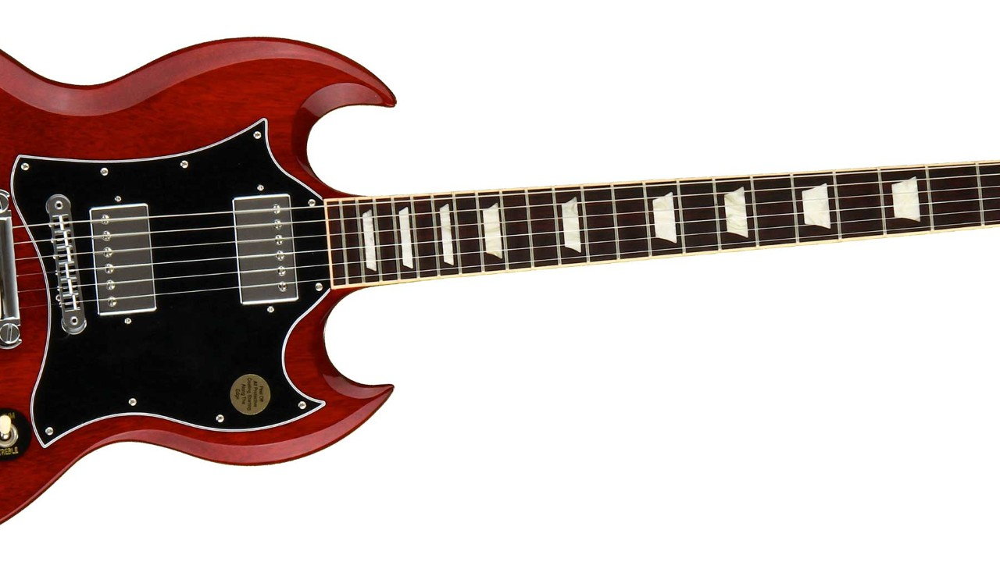

In [49]:
image_file = "guitar.jpg"

img = Image.open(image_file)
img

In [50]:
width, height = img.size

print(f"Image width = {width} height = {height}")

Image width = 1280 height = 720


In [51]:
prompt = """
Generate a high-energy promotional video showcasing a stylish modern guitar based on the provided image.
Feature the guitar being played by a guitarist, with dramatic cinematic lighting and fluid camera movements.
Highlight glossy surface reflections, dynamic lens flares, and a sense of motion and excitement.
The setting should convey a premium, aspirational atmosphere with warm tones and a futuristic edge.
Apply a soft depth-of-field effect for a cinematic finish, and complement the visuals with powerful rock music.
Just print 'Guitar for rock' at the end of the video.
"""

In [52]:
sora2_videofile = image_to_video_sora2(prompt, image_file, size="1280x720", seconds="8")

===== 🎨 Creating SORA-2 video using Azure AI Foundry =====

Input image: guitar.jpg
Prompt: 
Generate a high-energy promotional video showcasing a stylish modern guitar based on the provided image.
Feature the guitar being played by a guitarist, with dramatic cinematic lighting and fluid camera movements.
Highlight glossy surface reflections, dynamic lens flares, and a sense of motion and excitement.
The setting should convey a premium, aspirational atmosphere with warm tones and a futuristic edge.
Apply a soft depth-of-field effect for a cinematic finish, and complement the visuals with powerful rock music.
Just print 'Guitar for rock' at the end of the video.

📹 Video ID: video_68f745f32720819092277eb86f2c5e71
⏳ Initial Status: queued

[21-Oct-2025 08:36:04] ⏱️ Status: queued
[21-Oct-2025 08:36:14] ⏱️ Status: in_progress
[21-Oct-2025 08:36:24] ⏱️ Status: in_progress
[21-Oct-2025 08:36:35] ⏱️ Status: in_progress
[21-Oct-2025 08:36:45] ⏱️ Status: in_progress
[21-Oct-2025 08:36:55] ⏱️ S

In [53]:
Video(sora2_videofile, width=1024, embed=True)

In [54]:
video_link = FileLink(path=sora2_videofile)
video_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/sora2_video_21Oct2025_083833.mp4

## 7. All SORA-2 generated videos

In [75]:
zip_filename = os.path.join(VIDEO_DIR, "foundry_sora2_videos.zip")

print(f"📦 Zipping videos files from '{VIDEO_DIR}' to '{zip_filename}' ...")

with zipfile.ZipFile(zip_filename, 'w', zipfile.ZIP_DEFLATED) as zipf:
    for root, dirs, files in os.walk(VIDEO_DIR):
        for file in files:
            print(f"Zipping file {os.path.join(root, file)}")
            zipf.write(os.path.join(root, file), os.path.relpath(os.path.join(root, file), VIDEO_DIR))

print("✅ Done")
!ls $zip_filename -lh

📦 Zipping videos files from 'videos' to 'videos/foundry_sora2_videos.zip' ...
Zipping file videos/foundry_sora2_videos.zip
Zipping file videos/sora2_video_21Oct2025_081139.mp4
Zipping file videos/sora2_video_21Oct2025_081353.mp4
Zipping file videos/sora2_video_21Oct2025_081640.mp4
Zipping file videos/sora2_video_21Oct2025_082109.mp4
Zipping file videos/sora2_video_21Oct2025_082514.mp4
Zipping file videos/sora2_video_21Oct2025_083503.mp4
Zipping file videos/sora2_video_21Oct2025_083833.mp4
✅ Done
-rwxrwxrwx 1 root root 16M Oct 21 08:49 videos/foundry_sora2_videos.zip


In [76]:
zip_link = FileLink(path=zip_filename)
zip_link

/mnt/batch/tasks/shared/LS_root/mounts/clusters/standardd48/code/Users/seretkow/Sora2/videos/foundry_sora2_videos.zip